# ストリップチャート

## 概要

**ストリップチャート**とは，

## Plotlyによる作図方法

## MADB Labを用いた作図例

### 下準備

In [1]:
import pandas as pd
import plotly.express as px

import warnings
warnings.filterwarnings('ignore')

In [2]:
# 前処理の結果，以下に分析対象ファイルが格納されていることを想定
PATH_DATA = '../../data/preprocess/out/episodes.csv'
# Jupyter Book用のPlotlyのrenderer
RENDERER = 'plotly_mimetype+notebook'

In [3]:
# 平均掲載位置を算出する際の最小連載数
MIN_WEEKS = 5

In [4]:
def show_fig(fig):
    """Jupyter Bookでも表示可能なようRendererを指定"""
    fig.update_layout(margin=dict(t=50, l=25, r=25, b=25))
    fig.show(renderer=RENDERER)

In [5]:
df = pd.read_csv(PATH_DATA)

### 長期連載作品の掲載位置の分布

In [6]:
df_tmp = \
    df.groupby('cname')['pageStartPosition']\
    .agg(['count', 'mean']).reset_index()
df_tmp = \
    df_tmp.sort_values('count', ascending=False, ignore_index=True)\
    .head(10)
cname2position = df_tmp.groupby('cname')['mean'].first().to_dict()

In [7]:
df_plot = df[df['cname'].isin(list(cname2position.keys()))]\
    .reset_index(drop=True)
df_plot['position'] = df_plot['cname'].apply(
    lambda x: cname2position[x])
df_plot = df_plot.sort_values('position', ignore_index=True)

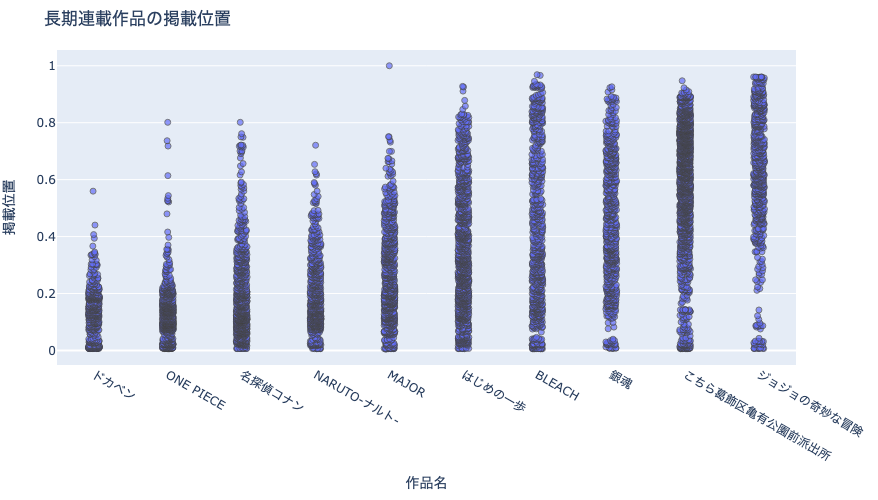

In [12]:
fig = px.strip(
    df_plot, x='cname', y='pageStartPosition',
    title='長期連載作品の掲載位置', height=500)
fig.update_traces(marker={'line_width':1, 'opacity':0.7})
fig.update_xaxes(title='作品名')
fig.update_yaxes(title='掲載位置')
show_fig(fig)

### 長期連載作品の話数毎の掲載位置の分布

In [14]:
# 話数の区切り
UNIT_EP = 200

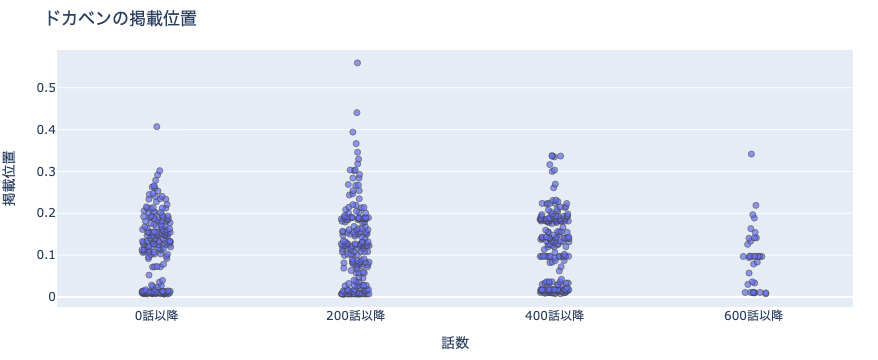

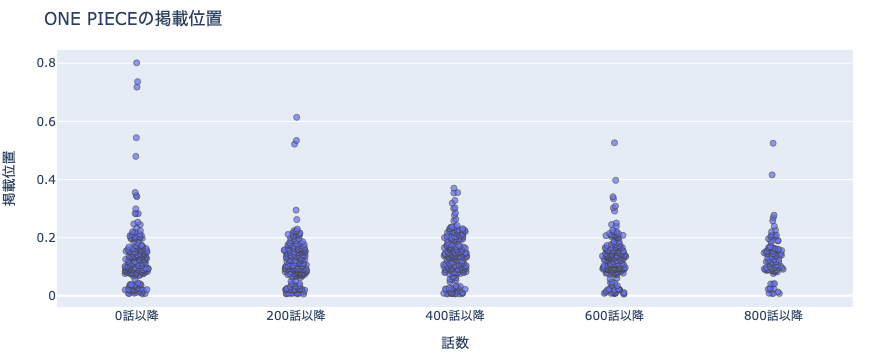

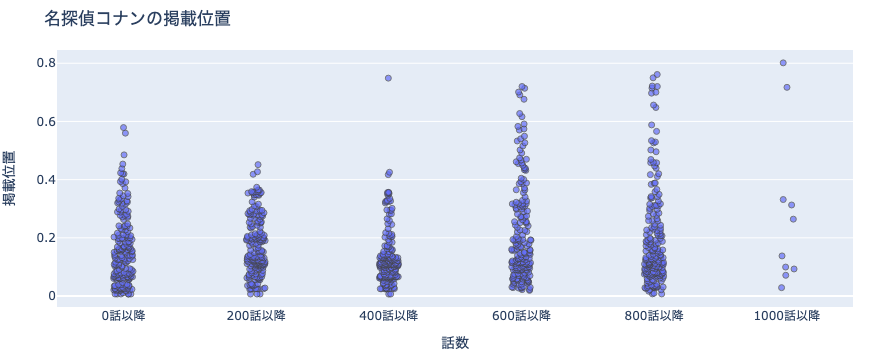

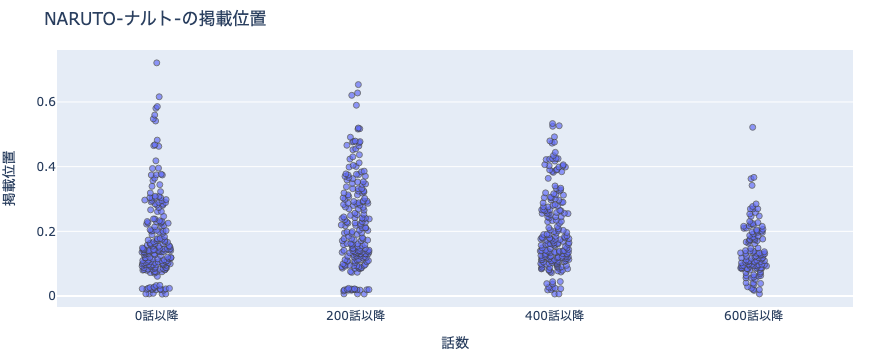

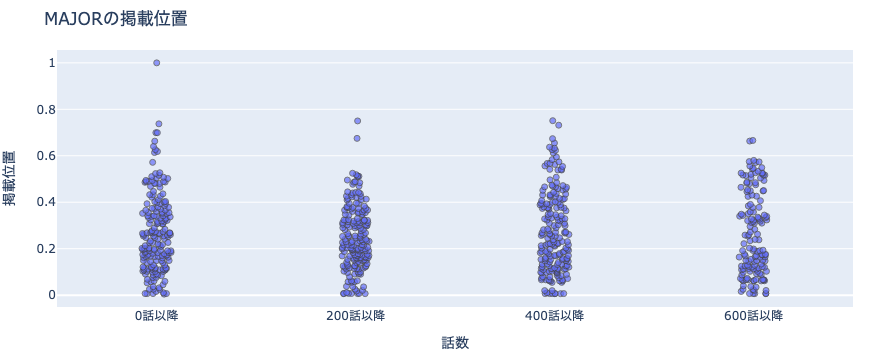

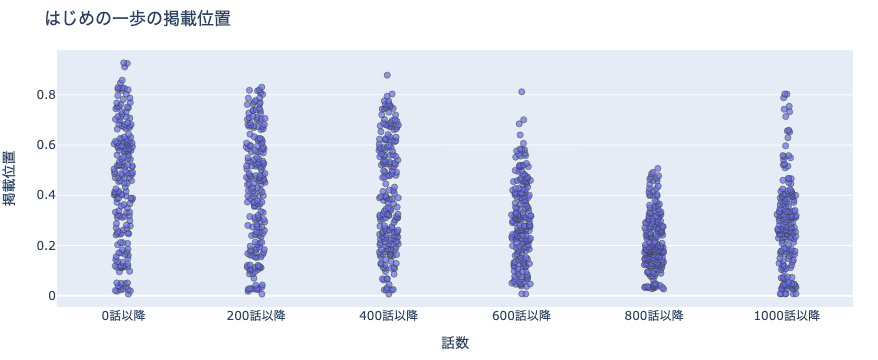

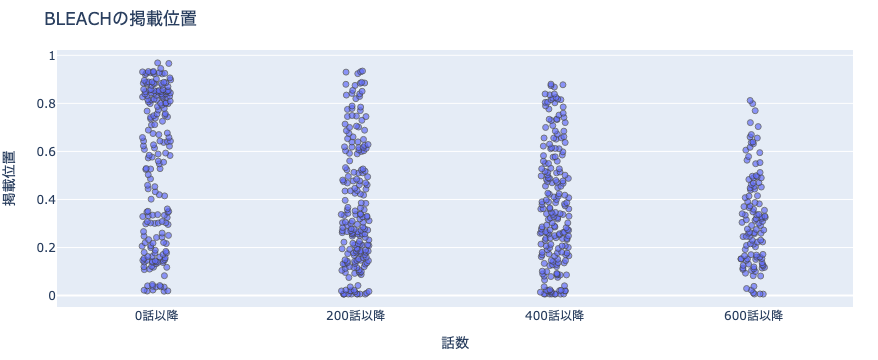

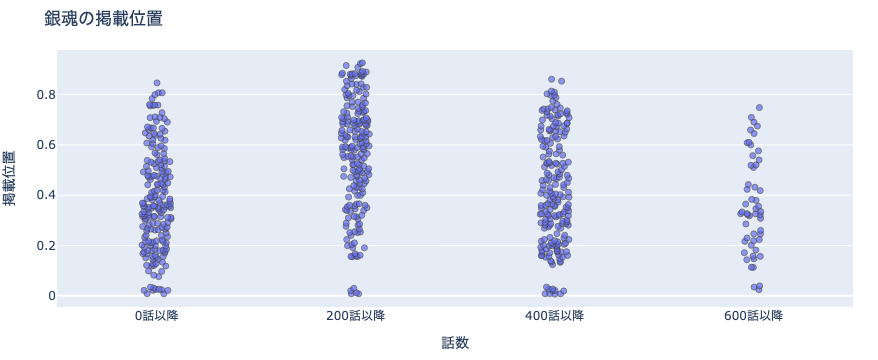

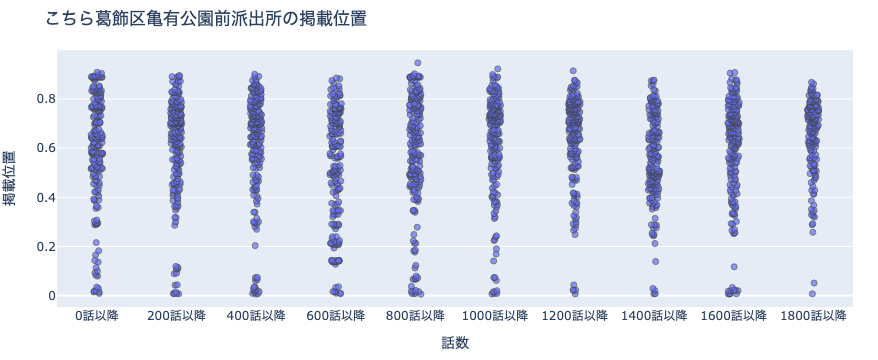

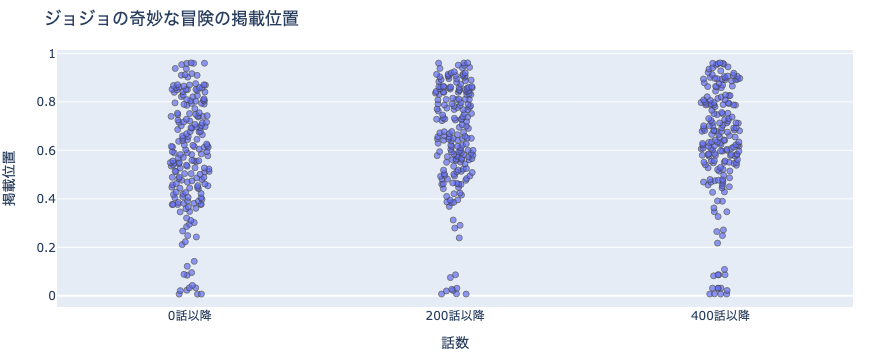

In [15]:
cnames = df_plot['cname'].unique()
for cname in cnames:
    df_c = df_plot[df_plot['cname']==cname].reset_index(drop=True)
    df_c['eprange'] = (df_c.index + 1) // UNIT_EP * UNIT_EP
    df_c['eprange'] = df_c['eprange'].apply(
        lambda x: f'{x}話以降')
    fig = px.strip(
        df_c, x='eprange', y='pageStartPosition',
        title=f'{cname}の掲載位置')
    fig.update_traces(marker={'line_width':1, 'opacity':0.7})
    fig.update_xaxes(title='話数')
    fig.update_yaxes(title='掲載位置')
    show_fig(fig)